In [384]:
import os
import sys
import einops
import torch as t
from torch import Tensor
import torch.nn as nn
import torch.nn.functional as F
import circuitsvis as cv
from miexperiments.utils.plotly_utils import imshow, hist, plot_comp_scores, plot_logit_attribution, plot_loss_difference, line
from miexperiments.utils.plotly_utils import plot_cosine_sim, plot_dot_product
from transformer_lens.hook_points import HookPoint
from transformer_lens import utils, HookedTransformer, HookedTransformerConfig, FactoredMatrix, ActivationCache
import numpy as np
import math
from tqdm.notebook import tqdm
from typing import Tuple, List, Optional, Dict
from jaxtyping import Float, Int
from matplotlib import pyplot as plt
from matplotlib.ticker import ScalarFormatter
from sklearn.manifold import TSNE
from IPython.display import display, HTML
import miexperiments.utils.matplot_utils as matplot_utils
import miexperiments.utils.logit_utils as logit_utils
from miexperiments.utils import *
from sklearn.decomposition import PCA

device = t.device("cuda" if t.cuda.is_available() else "cpu")
t.set_grad_enabled(False)

ipython = get_ipython()
ipython.magic("load_ext autoreload")
ipython.magic("autoreload 2")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


/var/folders/rp/dmbbthp17vdc__2336dxqvvr0000gn/T/ipykernel_49230/668643677.py:31: DeprecationWarning:

`magic(...)` is deprecated since IPython 0.13 (warning added in 8.1), use run_line_magic(magic_name, parameter_s).

/var/folders/rp/dmbbthp17vdc__2336dxqvvr0000gn/T/ipykernel_49230/668643677.py:32: DeprecationWarning:

`magic(...)` is deprecated since IPython 0.13 (warning added in 8.1), use run_line_magic(magic_name, parameter_s).



In [2]:
p = 113

model_cfg = HookedTransformerConfig(
    n_layers = 1,
    d_vocab = p+1,
    d_model = 128,
    d_mlp = 4 * 128,
    n_heads = 4,
    d_head = 128 // 4,
    n_ctx = 3,
    act_fn = "relu",
    normalization_type = None,
    device = device
)

In [3]:
model_checkpoints = t.load("../models/grokking_model_checkpoints.pt", map_location=device)
model_state_before_grokking = model_checkpoints["step_5001"]["model_state_dict"]
model_state_after_grokking = model_checkpoints["step_15001"]["model_state_dict"]

In [4]:
model = HookedTransformer(model_cfg)
model.load_state_dict(model_state_after_grokking)
model.eval()

HookedTransformer(
  (embed): Embed()
  (hook_embed): HookPoint()
  (pos_embed): PosEmbed()
  (hook_pos_embed): HookPoint()
  (blocks): ModuleList(
    (0): TransformerBlock(
      (ln1): Identity()
      (ln2): Identity()
      (attn): Attention(
        (hook_k): HookPoint()
        (hook_q): HookPoint()
        (hook_v): HookPoint()
        (hook_z): HookPoint()
        (hook_attn_scores): HookPoint()
        (hook_pattern): HookPoint()
        (hook_result): HookPoint()
      )
      (mlp): MLP(
        (hook_pre): HookPoint()
        (hook_post): HookPoint()
      )
      (hook_q_input): HookPoint()
      (hook_k_input): HookPoint()
      (hook_v_input): HookPoint()
      (hook_attn_out): HookPoint()
      (hook_mlp_in): HookPoint()
      (hook_mlp_out): HookPoint()
      (hook_resid_pre): HookPoint()
      (hook_resid_mid): HookPoint()
      (hook_resid_post): HookPoint()
    )
  )
  (unembed): Unembed()
)

In [5]:
print(f"1 + 1 = {model(t.tensor([(1, 1, p)])).argmax().item()}")
print(f"73 + 4 = {model(t.tensor([(73, 4, p)])).argmax().item()}")
print(f"99 + 99 = {model(t.tensor([(99, 99, p)])).argmax().item()}")

1 + 1 = 2
73 + 4 = 33
99 + 99 = 85


In [7]:
tokens = t.tensor([(1, 1, p)])
logits, cache = model.run_with_cache(tokens, remove_batch_dim=True)
logits = logits[0]

In [ ]:
# taken from nina rimsky's exp repo
def plot_decoded_activations_for_layer(cache, , tokens, topk=10):
    self.get_logits(tokens)
    cache[]
    layer = self.model.model.layers[layer_number]

    data = {}
    data["Attention mechanism"] = self.get_activation_data(
        layer.attn_out_unembedded, topk
    )[1]
    data["Intermediate residual stream"] = self.get_activation_data(
        layer.intermediate_resid_unembedded, topk
    )[1]
    data["MLP output"] = self.get_activation_data(layer.mlp_out_unembedded, topk)[1]
    data["Block output"] = self.get_activation_data(
        layer.block_output_unembedded, topk
    )[1]

    # Plotting
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 6))
    fig.suptitle(f"Layer {layer_number}: Decoded Intermediate Outputs", fontsize=21)

    for ax, (mechanism, values) in zip(axes.flatten(), data.items()):
        tokens, scores = zip(*values)
        ax.barh(tokens, scores, color="skyblue")
        ax.set_title(mechanism)
        ax.set_xlabel("Value")
        ax.set_ylabel("Token")

        # Set scientific notation for x-axis labels when numbers are small
        ax.xaxis.set_major_formatter(ScalarFormatter(useMathText=True))
        ax.ticklabel_format(style="sci", scilimits=(0, 0), axis="x")

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

In [9]:
top_k_tokens, top_k_logits = miexperiments.logit_utils.get_top_k_logits(logits, k=5, only_last_element=True)
top_k_tokens_as_str = [str(token.item()) for token in top_k_tokens]

NameError: name 'miexperiments' is not defined

In [11]:
top_k_tokens, top_k_logits = logit_utils.get_top_k_logits(logits, k=5, only_last_element=True)
top_k_tokens_as_str = [str(token.item()) for token in top_k_tokens]

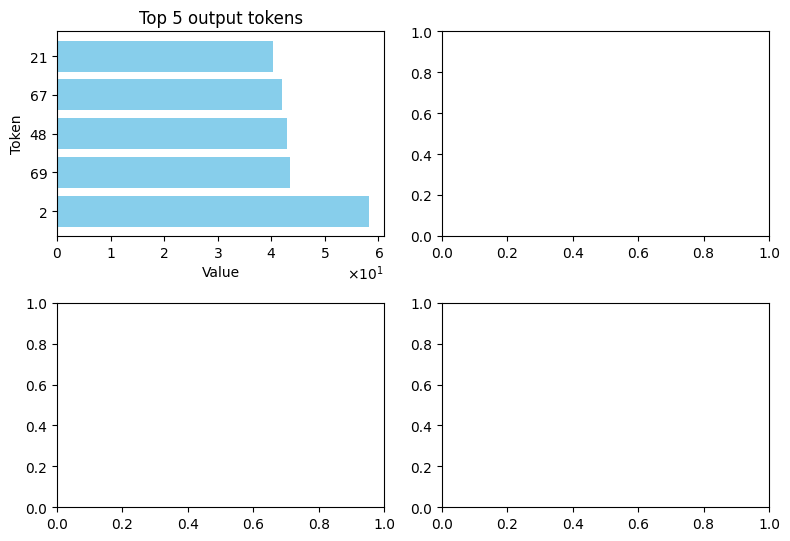

In [12]:
matplot_utils.plot_top_k_tokens(top_k_tokens_as_str, top_k_logits, topk=5)

In [13]:
activation_names = list(cache.keys())
print("List of activations:")
print(*activation_names, sep="\n")

List of activations:
hook_embed
hook_pos_embed
blocks.0.hook_resid_pre
blocks.0.attn.hook_q
blocks.0.attn.hook_k
blocks.0.attn.hook_v
blocks.0.attn.hook_attn_scores
blocks.0.attn.hook_pattern
blocks.0.attn.hook_z
blocks.0.hook_attn_out
blocks.0.hook_resid_mid
blocks.0.mlp.hook_pre
blocks.0.mlp.hook_post
blocks.0.hook_mlp_out
blocks.0.hook_resid_post


### First look at the heads
- What happens when the two numbers are the same?
- What are some common patterns in the heads?

In [14]:
batch = t.tensor(
    [(1, 1, p),
    (57, 57, p),
    (58, 58, p),
    (59, 59, p)]
)
logits, cache = model.run_with_cache(batch)
str_tokens = [[str(token.item()) + " " for token in seq] for seq in batch]
print(f"Inputs: {str_tokens}")
print(f"Outputs: {logits[:,-1].argmax(dim=-1)}")

Inputs: [['1 ', '1 ', '113 '], ['57 ', '57 ', '113 '], ['58 ', '58 ', '113 '], ['59 ', '59 ', '113 ']]
Outputs: tensor([2, 1, 3, 5])


In [194]:
cv.attention.from_cache(
    cache=cache,
    tokens=str_tokens,
    mode="large",
    return_mode="browser"
)

### Looking at times 2 multiplication (the 2 numbers are equal)
- In this case the attention pattern is "trivial"

In [197]:
# let's look at the values of the attention heads
values = cache["blocks.0.attn.hook_v"]
print(values.shape)

torch.Size([4, 3, 4, 32])


In [204]:
values[0, -1].shape

torch.Size([4, 32])

In [206]:
# what is the value of the "=" token?
# do the different attention heads have a similar value?
dot_prod_last_val = einops.einsum(
    values[0,-1], values[0,-1],
    "head_index_i d_head, head_index_j d_head -> head_index_i head_index_j"
)

imshow(
    dot_prod_last_val, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="How close are the values of the different head for the last token", 
    text_auto=".2f",
    width=400, height=400
)

# we can pretty much assume they're orthogonal to each other
# also, the last position never attends to itself so it's irrelevant

In [ ]:
# what is the value of the "=" token?
# do the different attention heads have a similar value?
dot_prod_last_val = einops.einsum(
    values[0,-1], values[0,-1],
    "head_index_i d_head, head_index_j d_head -> head_index_i head_index_j"
)

imshow(
    dot_prod_last_val, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="How close are the values of the different head for the last token", 
    text_auto=".2f",
    width=400, height=400
)

# we can pretty much assume they're orthogonal to each other
# and also it's not important which value because they don't get attended to by the last position

### How does the MLP work?

In [153]:
batch = t.tensor([
    (1, 1, p),
    (2, 2, p),
    (3, 3, p),
    (57, 57, p),
    (58, 58, p),
    (59, 59, p),
    (110, 110, p),
    (111, 111, p),
    (112, 112, p)
])
model.reset_hooks()
logits, cache = model.run_with_cache(batch)
str_tokens = [[str(token.item()) + " " for token in seq] for seq in batch]
print(f"Inputs: {str_tokens}")
print(f"Outputs: {logits[:,-1].argmax(dim=-1)}")

Inputs: [['1 ', '1 ', '113 '], ['2 ', '2 ', '113 '], ['3 ', '3 ', '113 '], ['57 ', '57 ', '113 '], ['58 ', '58 ', '113 '], ['59 ', '59 ', '113 '], ['110 ', '110 ', '113 '], ['111 ', '111 ', '113 '], ['112 ', '112 ', '113 ']]
Outputs: tensor([  2,   4,   6,   1,   3,   5, 107, 109, 111])


Remember we're just looking at the case where we're adding a + a (both tokens are the same)

In [163]:
# how is the residual output for the last position (right after the attention)
# influenced by the values we input?
resid_mid = cache["blocks.0.hook_resid_mid"][:,-1,:]
pre_mlp = cache["blocks.0.mlp.hook_pre"][:,-1,:]
# we only need the last position's pre-mlp vector
print(f"Pre mlp shape: {pre_mlp.shape}")
print(f"Resid mid shape: {resid_mid.shape}")

Pre mlp shape: torch.Size([9, 512])
Resid mid shape: torch.Size([9, 128])


In [164]:
print(f"Magnitudes of resid mid: {resid_mid.pow(2).sum(dim=-1).sqrt()}")
print(f"Magnitudes of pre-MLP: {pre_mlp.pow(2).sum(dim=-1).sqrt()}")

Magnitudes of resid mid: tensor([17.9653, 17.7499, 18.2701, 18.4630, 18.2570, 21.1425, 21.2286, 20.7255,
        18.3014])
Magnitudes of pre-MLP: tensor([ 82.5034,  79.0531,  81.5013,  84.4953,  84.6847, 100.0468,  98.9791,
         94.5774,  80.5242])


In [162]:
pre_mlp = cache["blocks.0.mlp.hook_pre"][:,-1,:]

# the norm of each individual vector
# remember the input numbers are:
# 1, 2, 3, 57, 58, 59, 110, 111 and 112
magnitudes = pre_mlp.pow(2).sum(dim=-1).sqrt()
print(f"Vector magnitudes:\n{magnitudes}")
magnitudes = einops.rearrange(magnitudes, "batch -> batch 1")
print(f"Shape of magnitude vector is {magnitudes.shape}")

# how do these vectors look like? Are they orthogonal?
# we will later try it out with any other possible vector

# no need to do this, they're already close to unit vectors
# pre_mlp /= magnitudes

dot_prod = einops.einsum(
    pre_mlp, pre_mlp,
    "batch_i d_model, batch_j d_model -> batch_i batch_j"
)

print(f"Average dot product mean is {dot_prod.mean()}")

imshow(
    dot_prod, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="How close are the resid vectors pre-MLP?", 
    text_auto=".2f",
    width=600, height=600
)

# normalizing
dot_prod = (dot_prod - dot_prod.mean()) / dot_prod.std()

imshow(
    dot_prod, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="(NORMALIZED VERSION) How close are the resid vectors pre-MLP?", 
    text_auto=".2f",
    width=600, height=600
)

Vector magnitudes:
tensor([ 82.5034,  79.0531,  81.5013,  84.4953,  84.6847, 100.0468,  98.9791,
         94.5774,  80.5242])
Shape of magnitude vector is torch.Size([9, 1])
Average dot product mean is 540.8226318359375


mmm why are the vectors so big???
why do they get bigger in the MLP pre hook?
Am I misunderstanding the mlp.hook_pre thing? Definitely yes
The mlp.hook_pre is actually the hidden layer, right?

What is the actual cross-product between 

In [168]:
# batch = t.tensor([(1, 1, p), (56, 56, p), (57, 57, p)])
batch = t.tensor([(i, i, p) for i in range(p)])
logits, cache = model.run_with_cache(batch)
str_tokens = [[str(token.item()) + " " for token in seq] for seq in batch]
print(f"Inputs: {str_tokens}")
print(f"Outputs: {logits[:,-1].argmax(dim=-1)}")

Inputs: [['0 ', '0 ', '113 '], ['1 ', '1 ', '113 '], ['2 ', '2 ', '113 '], ['3 ', '3 ', '113 '], ['4 ', '4 ', '113 '], ['5 ', '5 ', '113 '], ['6 ', '6 ', '113 '], ['7 ', '7 ', '113 '], ['8 ', '8 ', '113 '], ['9 ', '9 ', '113 '], ['10 ', '10 ', '113 '], ['11 ', '11 ', '113 '], ['12 ', '12 ', '113 '], ['13 ', '13 ', '113 '], ['14 ', '14 ', '113 '], ['15 ', '15 ', '113 '], ['16 ', '16 ', '113 '], ['17 ', '17 ', '113 '], ['18 ', '18 ', '113 '], ['19 ', '19 ', '113 '], ['20 ', '20 ', '113 '], ['21 ', '21 ', '113 '], ['22 ', '22 ', '113 '], ['23 ', '23 ', '113 '], ['24 ', '24 ', '113 '], ['25 ', '25 ', '113 '], ['26 ', '26 ', '113 '], ['27 ', '27 ', '113 '], ['28 ', '28 ', '113 '], ['29 ', '29 ', '113 '], ['30 ', '30 ', '113 '], ['31 ', '31 ', '113 '], ['32 ', '32 ', '113 '], ['33 ', '33 ', '113 '], ['34 ', '34 ', '113 '], ['35 ', '35 ', '113 '], ['36 ', '36 ', '113 '], ['37 ', '37 ', '113 '], ['38 ', '38 ', '113 '], ['39 ', '39 ', '113 '], ['40 ', '40 ', '113 '], ['41 ', '41 ', '113 '], ['4

In [175]:
resid_mid = cache["blocks.0.hook_resid_mid"][:,-1,:]

# the norm of each individual vector
# remember the input numbers are:
# 1, 2, 3, 57, 58, 59, 110, 111 and 112
magnitudes = resid_mid.pow(2).sum(dim=-1).sqrt()
print(f"Mean of vector magnitudes:\n{magnitudes.mean()}")
magnitudes = einops.rearrange(magnitudes, "batch -> batch 1")
print(f"Shape of magnitude vector is {magnitudes.shape}")

# how do these vectors look like? Are they orthogonal?
# we will later try it out with any other possible vector

# no need to do this, they're already close to unit vectors
resid_mid /= magnitudes

dot_prod = einops.einsum(
    resid_mid, resid_mid,
    "batch_i d_model, batch_j d_model -> batch_i batch_j"
)

imshow(
    dot_prod, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="How similar are the residual vectors (for the last position) after the 1st attention?", 
    text_auto=".2f",
    width=600, height=600,
)

Mean of vector magnitudes:
1.0
Shape of magnitude vector is torch.Size([113, 1])


Whaaaaaat is this!??!?!?! Notice the periodic pattern. Interestingly the pattern is exactly the same for each index, it's just shifted.

But anyways, let's keep trying to understand the sum and then we'll probably get some more insights about the pattern (maybe it's the other way around?). If I get stuck I'll go back to this.

In [195]:
all_numbers = t.tensor([(i, i, p) for i in range(p)])

In [196]:
# let's start with (1, 1, p)
# batch = t.tensor([(1, 1, p), (56, 56, p), (57, 57, p)])
# batch = t.tensor([(1, 1, p)])
batch = all_numbers
logits, cache = model.run_with_cache(batch)
str_tokens = [[str(token.item()) + " " for token in seq] for seq in batch]
print(f"Inputs: {str_tokens}")
print(f"Outputs: {logits[:,-1].argmax(dim=-1)}")

Inputs: [['0 ', '0 ', '113 '], ['1 ', '1 ', '113 '], ['2 ', '2 ', '113 '], ['3 ', '3 ', '113 '], ['4 ', '4 ', '113 '], ['5 ', '5 ', '113 '], ['6 ', '6 ', '113 '], ['7 ', '7 ', '113 '], ['8 ', '8 ', '113 '], ['9 ', '9 ', '113 '], ['10 ', '10 ', '113 '], ['11 ', '11 ', '113 '], ['12 ', '12 ', '113 '], ['13 ', '13 ', '113 '], ['14 ', '14 ', '113 '], ['15 ', '15 ', '113 '], ['16 ', '16 ', '113 '], ['17 ', '17 ', '113 '], ['18 ', '18 ', '113 '], ['19 ', '19 ', '113 '], ['20 ', '20 ', '113 '], ['21 ', '21 ', '113 '], ['22 ', '22 ', '113 '], ['23 ', '23 ', '113 '], ['24 ', '24 ', '113 '], ['25 ', '25 ', '113 '], ['26 ', '26 ', '113 '], ['27 ', '27 ', '113 '], ['28 ', '28 ', '113 '], ['29 ', '29 ', '113 '], ['30 ', '30 ', '113 '], ['31 ', '31 ', '113 '], ['32 ', '32 ', '113 '], ['33 ', '33 ', '113 '], ['34 ', '34 ', '113 '], ['35 ', '35 ', '113 '], ['36 ', '36 ', '113 '], ['37 ', '37 ', '113 '], ['38 ', '38 ', '113 '], ['39 ', '39 ', '113 '], ['40 ', '40 ', '113 '], ['41 ', '41 ', '113 '], ['4

In [183]:
# what are the residual vectors corresponding to the unembedding tokens for 1, 56 and 57?
unembed_1, unembed_56, unembed_57 = einops.rearrange(
    model.W_U[:,[1,56,57]], "d_model n_vectors -> n_vectors d_model"
)

In [197]:
# are the unembedding vectors actually close to the input tokens themselves?
dot_product_emb_and_unemb = einops.einsum(
    model.W_E, model.W_U,
    "token_i d_model, d_model token_j -> token_i token_j"
)

emb = einops.einsum(
    model.W_E, model.W_E,
    "token_i d_model, token_j d_model -> token_i token_j"
)

unemb = einops.einsum(
    model.W_U, model.W_U,
    "d_model token_i, d_model token_j -> token_i token_j"
)
print(f"Average dot product of same-token embedding and unembedding:\n{dot_product_emb_and_unemb.diagonal().mean()}")
print(f"Average squared norm of embeddings:\n{emb.diagonal().mean()}")
print(f"Average squared norm of unembeddings:\n{unemb.diagonal().mean()}")

imshow(
    emb, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="Dot product between embeddings", 
    text_auto=".2f",
    width=600, height=600,
)

imshow(
    unemb, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="Dot product between UNembeddings", 
    text_auto=".2f",
    width=600, height=600,
)

imshow(
    dot_product_resid_mid_and_unemb, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="How similar are the embeddings and unembedings?", 
    text_auto=".2f",
    width=600, height=600,
)

tensor(112)
113
torch.Size([113, 128])
Shape of shifted resid mid is torch.Size([113, 128])
Average dot product of same-token embedding and unembedding:
-0.023903733119368553
Average squared norm of embeddings:
1.3208909034729004
Average squared norm of unembeddings:
0.9342033267021179


there is also some kind of periodic pattern here but it's less clear than in the one we had previously... 

In [198]:
# what is the relation between resid mid and the correct output logit's unembedding vector?
resid_mid = cache["blocks.0.hook_resid_mid"][:,-1,:]
# we have to select only certain indices
idx = t.tensor([(2 * i) % p for i in range(p)])
print(idx.max())
print(len(idx))
print(resid_mid.shape)
shifted_resid_mid = resid_mid.index_select(0, idx)
print(f"Shape of shifted resid mid is {shifted_resid_mid.shape}")

dot_product_resid_mid_and_unemb = einops.einsum(
    shifted_resid_mid, model.W_U,
    "token_i d_model, d_model token_j -> token_i token_j"
)

imshow(
    dot_product_emb_and_unemb, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="How similar is resid mid and the corresponding unembeding?", 
    text_auto=".2f",
    width=600, height=600,
)

tensor(112)
113
torch.Size([113, 128])
Shape of shifted resid mid is torch.Size([113, 128])


Don't really know what to do know, I'm a bit stuck. I guess the easiest thing would be to go back and investigate the embedding matrix and the residual after the attention. I would assume we're performing some kind of rotation since we get dot products of -1 sometimes for different vectors.

Maybe we can try to decompose the periodic pattern we see in the embedding matrix into its different frequency components?

In [262]:
emb = einops.einsum(
    model.W_E, model.W_E,
    "token_i d_model, token_j d_model -> token_i token_j"
)

imshow(
    emb, 
    labels={"x": "j", "y": "i", "color": "Dot prod"},
    title="Dot product between embeddings", 
    text_auto=".2f",
    width=600, height=600,
)

In [301]:
plot_cosine_sim(W_E, W_E)

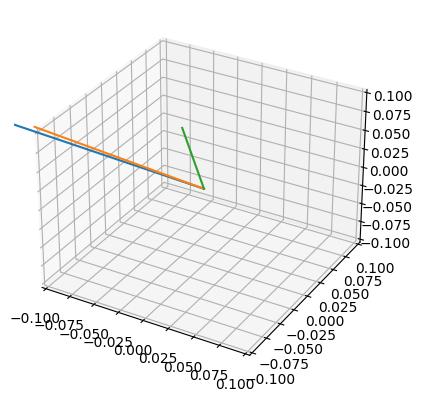

In [286]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Generate some sample data
vectors = [W_E[1], W_E[2], W_E[4]]

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot each vector as a line segment starting at origin
for v in vectors:
    ax.plot([0,v[0]], [0,v[1]], [0,v[2]]) 

ax.set_xlim(-0.1,0.1)
ax.set_ylim(-0.1,0.1)
ax.set_zlim(-0.1,0.1)

plt.show()

In [273]:
imshow(S)

ValueError: px.imshow only accepts 2D single-channel, RGB or RGBA images. An image of shape (113,) was provided. Alternatively, 3- or 4-D single or multichannel datasets can be visualized using the `facet_col` or/and `animation_frame` arguments.

In [266]:
mean_vector = model.W_E[:-1].mean(dim=0)


torch.Size([128])

In [224]:
model.W_E[2] @

tensor([-0.2742,  0.1315, -0.1041,  0.0112, -0.0545,  0.1476, -0.0950, -0.1796,
         0.0699, -0.0660, -0.0246,  0.1261,  0.0609,  0.0585, -0.1776,  0.0649,
        -0.1211, -0.0258, -0.0789, -0.0830,  0.0194, -0.0436,  0.0441,  0.0544,
         0.1458, -0.0952, -0.0170, -0.1562, -0.0665,  0.0213,  0.1086,  0.1029,
         0.0319,  0.2541,  0.0249, -0.0194,  0.0376,  0.0727, -0.1492,  0.0153,
        -0.1731, -0.0394,  0.1360,  0.0016,  0.0465,  0.1851, -0.0860, -0.0044,
         0.1111,  0.0184,  0.0476, -0.0696,  0.0571,  0.1573, -0.0215, -0.0687,
        -0.0078, -0.0034,  0.1679, -0.1294, -0.2022, -0.0869, -0.0671, -0.0603,
        -0.0361,  0.0334,  0.0396, -0.1099,  0.0265, -0.0238,  0.2034, -0.0902,
         0.0341, -0.1223,  0.0372, -0.1013, -0.0080, -0.1236, -0.0323, -0.0418,
         0.0825,  0.0667, -0.0145, -0.0371, -0.1828,  0.2308,  0.0995,  0.0709,
         0.1042, -0.1403, -0.1478, -0.0167,  0.0414,  0.0120, -0.0853,  0.0364,
         0.2217, -0.0444, -0.0250,  0.06

In [248]:
plot_cosine_sim(model.W_E, cache["blocks.0.hook_resid_mid"][:,-1,:])

In [259]:
from sympy import fourier_series, pi
from sympy.abc import x

In [260]:
fn = lambda x: (x+x)%p
s = fourier_series(fn, (x, 0, 113))

/Users/oscarbalcells/anaconda3/envs/arena/lib/python3.8/site-packages/sympy/series/fourier.py:779: SymPyDeprecationWarning:



The string fallback in sympify() is deprecated.

To explicitly convert the string form of an object, use
sympify(str(obj)). To add define sympify behavior on custom
objects, use sympy.core.sympify.converter or define obj._sympy_
(see the sympify() docstring).

sympify() performed the string fallback resulting in the following string:

'<function <lambda> at 0x2a09f5b80>'

See https://docs.sympy.org/latest/explanation/active-deprecations.html#deprecated-sympify-string-fallback
for details.

This has been deprecated since SymPy version 1.6. It
will be removed in a future version of SymPy.




SympifyError: Sympify of expression 'could not parse '<function <lambda> at 0x2a09f5b80>'' failed, because of exception being raised:
SyntaxError: invalid syntax (<string>, line 1)

In [306]:
W_E = model.W_E[:-1]
mean_vector = W_E.mean(dim=0)
W_E -= mean_vector
U, S, Vh = t.linalg.svd(W_E)

print("Original dot product")
plot_cosine_sim(W_E, W_E)
plot_dot_product(W_E, W_E)

for n in range(1, 11):
    pca = PCA(n_components=n)
    W_E_pca = pca.fit_transform(W_E)
    print(f"{n} COMPONENTS PCA DOT PRODUCT")
    plot_cosine_sim(t.tensor(W_E_pca), t.tensor(W_E_pca))
    plot_dot_product(t.tensor(W_E_pca), t.tensor(W_E_pca))

Original dot product


1 COMPONENTS PCA DOT PRODUCT


2 COMPONENTS PCA DOT PRODUCT


3 COMPONENTS PCA DOT PRODUCT


4 COMPONENTS PCA DOT PRODUCT


5 COMPONENTS PCA DOT PRODUCT


6 COMPONENTS PCA DOT PRODUCT


7 COMPONENTS PCA DOT PRODUCT


8 COMPONENTS PCA DOT PRODUCT


9 COMPONENTS PCA DOT PRODUCT


10 COMPONENTS PCA DOT PRODUCT


In [309]:
pattern = einops.einsum(
    W_E, W_E,
    "i d_model, j d_model -> i j"
)[0]

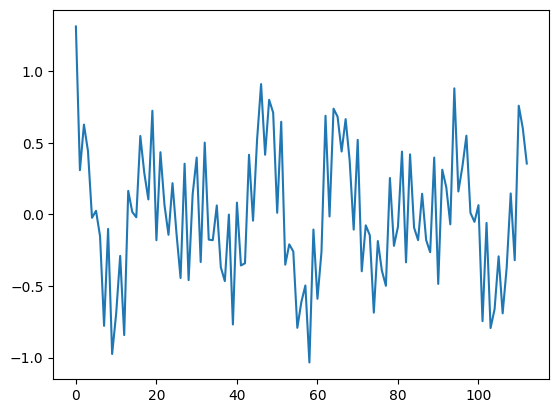

In [311]:
plt.plot(pattern)

In [316]:
import pandas as pd

In [319]:
df = pd.DataFrame(pattern.numpy(), columns=["y"])

In [320]:
df.head()

,y
0,1.312529
1,0.309125
2,0.627456
3,0.442615
4,-0.023619


In [321]:
df.to_csv("./fourier_pattern.csv")

In [322]:
X_k = np.fft.fft(pattern)

In [323]:
X_k

array([ 5.90109267e-07+1.33226763e-15j, -1.80037514e-01+1.66749363e-02j,
        3.61098747e-01+8.27283711e-01j,  4.61956713e-02-3.36461792e-01j,
       -7.58377928e-02+4.39395943e-01j,  1.95110424e+01-4.71974187e-01j,
        1.06818022e-01-9.49741234e-02j,  2.18424687e+01-1.17739960e-01j,
        8.72623517e-02-1.38720796e-01j,  7.39487027e-02-4.80644127e-03j,
       -4.60303260e-03-1.52450898e-01j, -4.67161089e-02-2.13112913e-01j,
        2.60397685e-01+5.53028479e-01j, -4.36764803e-01-3.61118495e-02j,
        1.36744703e+00+2.26644450e+00j,  3.12508057e-01+1.64278709e-01j,
        1.76033122e-01-1.89656110e-01j,  8.71225832e-02+2.66490592e-01j,
        1.04186693e-01-2.96242975e-01j,  3.37173072e-01+2.00371895e-01j,
        1.31498340e-02+1.69571203e-02j, -1.02646319e+00-2.00867999e-01j,
        2.04720102e-01+8.46132868e-02j,  1.34868755e-01+1.74532839e-01j,
        3.05208688e-02-4.94645002e-02j, -3.75772706e-02+2.49942038e-01j,
        2.41957578e-02-3.83127527e-01j,  1.26344952

In [324]:
reconstructed_x_t = np.fft.ifft(X_k)

/Users/oscarbalcells/anaconda3/envs/arena/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1340: ComplexWarning:

Casting complex values to real discards the imaginary part



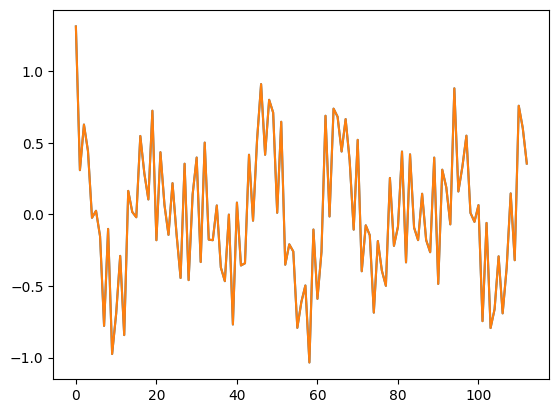

In [326]:

plt.plot(reconstructed_x_t, label="Reconstructed")
plt.plot(pattern, label="Pattern")

In [344]:
x_t = pattern.numpy()

# Calculate Fourier coefficients
N = len(x_t)
a_0 = np.mean(x_t)
a_n = 2/N * np.array([np.sum(x_t * np.cos(2 * np.pi * n * np.arange(N) / N)) for n in range(1, N//2+1)])
b_n = 2/N * np.array([np.sum(x_t * np.sin(2 * np.pi * n * np.arange(N) / N)) for n in range(1, N//2+1)])

a_n = a_n[:10]
b_n = b_n[:10]

# Reconstruct the array using the Fourier series
t = np.arange(N)
reconstructed_x_t = \
    a_0 + \
    np.sum([
        a * np.cos(2 * np.pi * n * t / N)
        for n, a in enumerate(a_n, 1)], axis=0) + \
    np.sum([
        b * np.sin(2 * np.pi * n * t / N)
        for n, b in enumerate(b_n, 1)], axis=0)

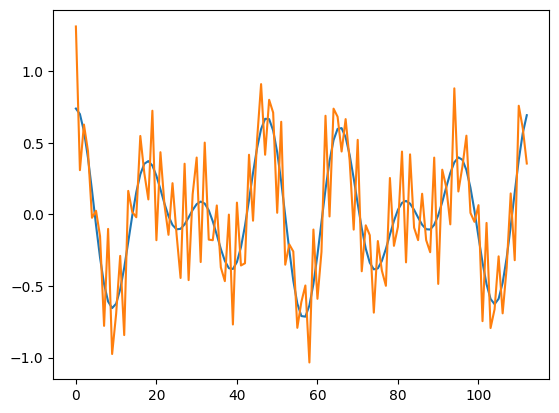

In [345]:
plt.plot(reconstructed_x_t, label="Reconstructed")
plt.plot(pattern, label="Original Pattern")

In [ ]:
x_t = pattern.numpy()

# Calculate Fourier coefficients
N = len(x_t)
a_0 = np.mean(x_t)
a_n = 2/N * np.array([np.sum(x_t * np.cos(2 * np.pi * n * np.arange(N) / N)) for n in range(1, N//2+1)])
b_n = 2/N * np.array([np.sum(x_t * np.sin(2 * np.pi * n * np.arange(N) / N)) for n in range(1, N//2+1)])

a_n = a_n[:10]
b_n = b_n[:10]

# Reconstruct the array using the Fourier series
t = np.arange(N)
reconstructed_x_t = \
    a_0 + \
    np.sum([
        a * np.cos(2 * np.pi * n * t / N)
        for n, a in enumerate(a_n, 1)], axis=0) + \
    np.sum([
        b * np.sin(2 * np.pi * n * t / N)
        for n, b in enumerate(b_n, 1)], axis=0)

In [348]:
# Generate a sample array of 113 elements (replace this with your own array)
N = len(x_t) 

# Perform FFT to get Fourier coefficients
X_k = np.fft.fft(x_t)

# Calculate the magnitudes of the Fourier coefficients
magnitudes = np.abs(X_k)

# Sort the coefficients by magnitude and get the indices of the top k coefficients
k = 5  # You can change k to another value
top_k_indices = np.argsort(magnitudes)[-k:]

# Create a new array of Fourier coefficients, setting all but the top k to zero
sparse_X_k = np.zeros(N, dtype=complex)
sparse_X_k[top_k_indices] = X_k[top_k_indices]

# Perform inverse FFT to reconstruct the original array
reconstructed_x_t = np.fft.ifft(sparse_X_k)

# Calculate the reconstruction error using L2 norm
error = np.linalg.norm(x_t - reconstructed_x_t)

print("Reconstruction error:", error)


Reconstruction error: 2.2055469005189043


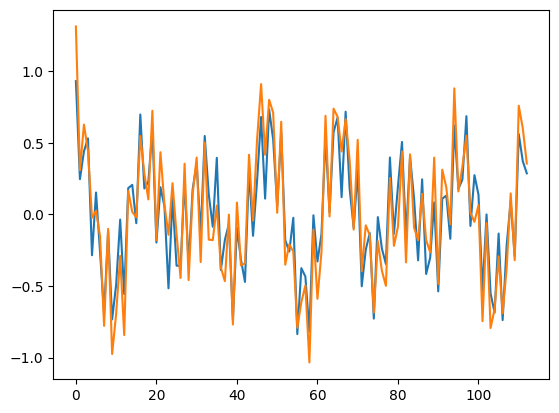

In [349]:
plt.plot(reconstructed_x_t, label="Reconstructed")
plt.plot(pattern, label="Original Pattern")

In [350]:
print(f"Top k indices are: {top_k_indices}")

Top k indices are: [108  71  42   7 106]


In [354]:
# Generate a sample array of 113 elements (replace this with your own array)
x_t = [(a+a)%p for a in range(113)]
N = len(x_t) 

# Perform FFT to get Fourier coefficients
X_k = np.fft.fft(x_t)

# Calculate the magnitudes of the Fourier coefficients
magnitudes = np.abs(X_k)

# Sort the coefficients by magnitude and get the indices of the top k coefficients
k = 10  # You can change k to another value
top_k_indices = np.argsort(magnitudes)[-k:]

# Create a new array of Fourier coefficients, setting all but the top k to zero
sparse_X_k = np.zeros(N, dtype=complex)
sparse_X_k[top_k_indices] = X_k[top_k_indices]

# Perform inverse FFT to reconstruct the original array
reconstructed_x_t = np.fft.ifft(sparse_X_k)

# Calculate the reconstruction error using L2 norm
error = np.linalg.norm(x_t - reconstructed_x_t)

print("Reconstruction error:", error)


Reconstruction error: 120.92153650931617


In [356]:
top_k_indices

array([103,   8, 105,   6, 107,   4, 109,   2, 111,   0])

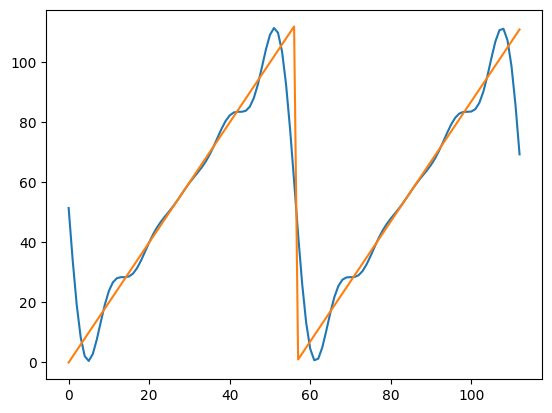

In [355]:
plt.plot(reconstructed_x_t, label="Reconstructed")
plt.plot(x_t, label="Original Pattern")

I think what I'm missing here is the link between the pattern and the input space, not the image of the function that we have to compute ((a+b)%p). The function we have to compute is clearly non-linear so it's just not possible for W_E to be able to encode it

what is the relationship between the input space and this periodic pattern? The image of our map W_E has this periodic pattern so it's like we can generate it all based out of one image vector which we can rotate in different ways

let's try to change the basis into the 1d fourier.


i'm a bit confused now as to what this basis should be like. Fourier is used to "build" periodic functions but in our case we just simply want to change the representation of our input into something where this periodic. so it's not really the fourier decomposition of the map (I guess? since it's not periodic??) but rather just change the basis in which we express the elements we plug into the map. Sort of change the way we represent the domain of the map W_E without thinking at all about how the map W_E looks like (atm) 

In [364]:
# generated by gpt-4:
fourier_basis = t.ones((p, p)) 
fourier_basis[0] = t.ones(p) / p

for k in range(1, p, 2):
    fourier_basis[k] = t.cos(2 * t.pi * t.arange(p) * k / p)
    fourier_basis[k] /= fourier_basis[k].norm()
    fourier_basis[k+1] = t.sin(2 * t.pi * t.arange(p) * k / p)
    fourier_basis[k+1] /= basis_sin[k+1].norm()


In [367]:
imshow(fourier_basis @ fourier_basis.T)

what if we change the basis of our vectors before feeding them to the matrix?

In [371]:
imshow(fourier_basis @ W_E)

????
what does this mean? how is this related to the plot about the pairwise dot product between embeddings?

it's kind of like the kernel of the matrix are almost all of the discrete fourier basis elements except for about 4?

In [375]:
(fourier_basis @ W_E).shape

torch.Size([113, 128])

In [395]:
fourier_map = fourier_basis @ W_E

In [377]:
print(fourier_map[5].norm())
print(fourier_map[6].norm())

tensor(4.3314)
tensor(nan)


In [378]:
f_norms = fourier_map.pow(2).sum(dim=1)

In [379]:
f_norms.shape

torch.Size([113])

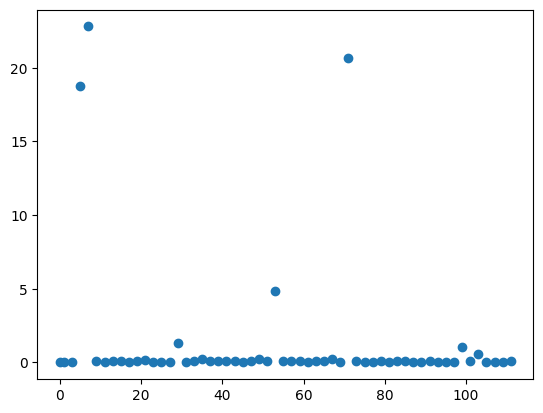

In [388]:
# let's plot the norm of each of the vectors depending on the fourier basis 
plt.scatter(x=t.arange(p), y=f_norms)

this is it!!!! basically the matrix is throwing out everything except for these few key frequencies

[]

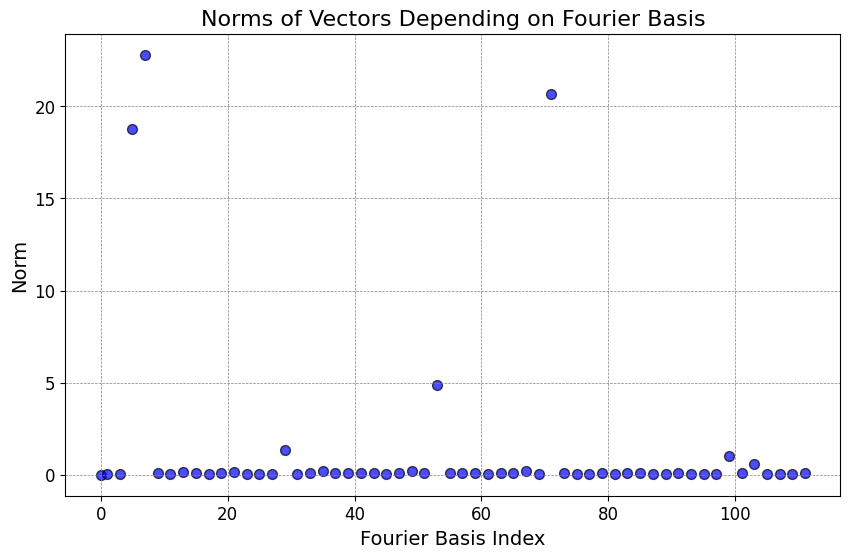

In [391]:
plt.figure(figsize=(10, 6))
plt.scatter(t.arange(p), f_norms, c='blue', alpha=0.7, edgecolors='black', s=50)

# Styling
plt.title('Norms of Vectors Depending on Fourier Basis', fontsize=16)
plt.xlabel('Fourier Basis Index', fontsize=14)
plt.ylabel('Norm', fontsize=14)
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.plot()

is the unembedding acting as the inv fourier transform then?

In [394]:
imshow(model.W_U[:,:-1] @ fourier_basis.T)

I guess what this means is that our model is essentially just performing like a change of basis and doing all calculations in the fourier space

In [396]:
# are the images of the fourier basis elements orthogonal to each other in
# the residual space?
plot_dot_product(fourier_map, fourier_map)

In [418]:
# what are the eigenfrequencies which aren't in the kernel of W_E?
f_norms = (fourier_map @ fourier_map.T).diagonal()
f_norms = t.nan_to_num(f_norms, nan=0)
top_norms, top_frequencies = t.topk(f_norms, k=8)

In [421]:
top_frequencies = [freq.item() for freq in top_frequencies]

Let's try now to interpret how the model does computations with these residual vectors that we're now able to understand.

Let's try to see how the model is computing the sum 1 + 1 know that we know that it will try to first express the number 1 as a linear combination of fourier basis elements 1 = const + \sum_k a_k cos(2 * pi * k / p) + \sum_k b_k sin(2 * pi * k / p)

In [427]:
fourier_basis[1].sum()

tensor(4.0978e-07)

In [426]:
fourier_basis[:,1].sum()

tensor(nan)

mmm??? shouldn't this give us 1?

hahahhaha okay noo. the 1 would be just the constant term of the fourier basis. we gotta look at the one-hot encoded vectors (that's the basis we start from)

In [ ]:
# fourier_basis = t.ones((p, p)) 
# fourier_basis[0] = t.ones(p) / p

# for k in range(1, p, 2):
#     fourier_basis[k] = t.cos(2 * t.pi * t.arange(p) * k / p)
#     fourier_basis[k] /= fourier_basis[k].norm()
#     fourier_basis[k+1] = t.sin(2 * t.pi * t.arange(p) * k / p)
#     fourier_basis[k+1] /= basis_sin[k+1].norm()

In [430]:
fourier_basis[1,:]

tensor([ 0.1330,  0.1328,  0.1322,  0.1312,  0.1298,  0.1279,  0.1257,  0.1231,
         0.1201,  0.1167,  0.1130,  0.1089,  0.1045,  0.0998,  0.0947,  0.0894,
         0.0838,  0.0779,  0.0718,  0.0654,  0.0589,  0.0522,  0.0453,  0.0383,
         0.0311,  0.0239,  0.0166,  0.0092,  0.0018, -0.0055, -0.0129, -0.0203,
        -0.0275, -0.0347, -0.0418, -0.0488, -0.0556, -0.0622, -0.0686, -0.0749,
        -0.0809, -0.0866, -0.0921, -0.0973, -0.1022, -0.1068, -0.1110, -0.1149,
        -0.1185, -0.1216, -0.1244, -0.1269, -0.1289, -0.1305, -0.1318, -0.1326,
        -0.1330, -0.1330, -0.1326, -0.1318, -0.1305, -0.1289, -0.1269, -0.1244,
        -0.1216, -0.1185, -0.1149, -0.1110, -0.1068, -0.1022, -0.0973, -0.0921,
        -0.0866, -0.0809, -0.0749, -0.0686, -0.0622, -0.0556, -0.0488, -0.0418,
        -0.0347, -0.0275, -0.0203, -0.0129, -0.0055,  0.0018,  0.0092,  0.0166,
         0.0239,  0.0311,  0.0383,  0.0453,  0.0522,  0.0589,  0.0654,  0.0718,
         0.0779,  0.0838,  0.0894,  0.09

i guess this is $e_1 \in R^p$ represented using the fourier basis $e_k$ is just fourier_basis[k,:]

i remember from my linalg course that the new basis element representation were the columns of this basis change matrix, but in this case the map A multiplies the input vector $x \in R^p$ from the left $x \mapsto x * A$, so in this case i guess they're the rows

In [431]:
top_frequencies

[7, 71, 5, 53, 29, 99, 103, 35]

can we just take one of these frequencies and ignore all others? Let's check if the orthogonality will be kept at least until the MLP hidden layer (right before the activation)

In [440]:
model.W_in.shape

torch.Size([1, 128, 512])

In [442]:
model.W_O.shape

torch.Size([1, 4, 32, 128])

In [448]:
# A[i] is the linear map from the input space to the MLP hidden layer
# assuming that we go through the i-th head and the attention pattern is
# the identity, which is the case if we input two equal numbers
A = model.W_E @ model.W_V[0] @ model.W_O[0] @ model.W_in[0]

In [451]:
A[0].shape

torch.Size([114, 512])

In [454]:
for i in range(4):
    imshow(
        A[i], 
        labels={"x": "i-th component of hidden vector", "y": "Input token", "color": "Dot produdct"},
        title=f"Dot product matrix", 
        text_auto=".2f",
        width=600, height=300,
    )

this is already a pretty interesting pattern
and we have periodicity in each non-zero column
what if we also apply the change of basis?

In [456]:
for i in range(4):
    imshow(
        fourier_basis @ A[i,:-1], 
        labels={"x": "i-th component of hidden vector", "y": "Input token", "color": "Dot produdct"},
        title=f"Dot product matrix", 
        text_auto=".2f",
        width=600, height=300,
    )

wow, this is an extremely sparse pattern.
so sparse that we can actually look at how the individual components get mapped

how is the vector for the 7-th fourier basis element mapped?

In [460]:
fourier_basis[7] @ model.W_E[:-1]

tensor([-0.9241,  0.0536, -0.3510,  0.2014, -0.0342,  0.2840,  0.0016,  0.0227,
        -0.0401,  0.6844, -0.4828,  0.5344,  0.0714,  0.3398, -0.1475, -0.3541,
        -0.6336, -0.0351, -0.0535, -0.7363, -0.3933, -0.4801, -0.2293,  0.1755,
         0.4134,  0.0280,  0.7503, -0.3630, -0.0592, -0.4134, -0.4555,  0.6920,
         0.2285,  0.7681, -0.2243, -0.6088,  0.0161,  0.2446, -0.2690, -0.1201,
        -0.0469,  0.0017,  0.9723,  0.3285,  0.0193, -0.1085, -0.5504,  0.6377,
        -0.7680,  0.3410, -0.3465, -0.8099, -0.4890,  0.3600, -0.1164, -0.2430,
         0.0232,  0.5395,  0.4870, -0.2258, -0.3227, -0.0161,  0.0509, -0.3989,
        -0.0465,  0.4869, -0.0723, -0.0783,  0.4456,  0.1030,  0.5385,  0.0033,
        -0.5681, -0.9100, -0.2612, -0.3620,  0.1118, -0.5901,  0.0054,  0.0632,
         0.3209,  0.0512, -0.9307,  0.2810,  0.0825,  0.4300,  0.5680, -0.1750,
         0.1570, -0.7305, -0.0961,  0.3630, -0.5108,  0.0283, -0.1402, -0.8380,
        -0.1061, -0.0720, -0.0030,  0.23

In [461]:
f_7_emb = fourier_basis[7] @ model.W_E[:-1]

In [463]:
f_7_out = fourier_basis[7] @ A[0][:-1]